In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import matplotlib
import matplotlib.pyplot as plt
import math

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import GCNConv, dense_diff_pool
import torch_explain as te
from torch_explain.logic.nn import entropy
from torch_explain.logic.metrics import test_explanation, complexity

import numpy as np
import pandas as pd
from pytorch_lightning.utilities.seed import seed_everything
from scipy.spatial.distance import cdist
from sympy import to_dnf, lambdify
from sklearn.metrics.cluster import homogeneity_score, completeness_score

import clustering_utils
import data_utils
import lens_utils
import model_utils
import persistence_utils
import visualisation_utils
import models

In [3]:
# constants
DATASET_NAME = "BA_Shapes"
MODEL_NAME = f"GCN for {DATASET_NAME}"
NUM_CLASSES = 4

TRAIN_TEST_SPLIT = 0.8

NUM_HIDDEN_UNITS = 20
N_CLUSTERING = 3
CONCEPT_EMB_SIZE = 10

EPOCHS = 5000
LR = 0.001

NUM_NODES_VIEW = 5
NUM_EXPANSIONS = 2

LAYER_NUM = 3
LAYER_KEY = "conv3"

visualisation_utils.set_rc_params()

In [4]:
def run_experiment(data, seed, path):
    config = {'seed': seed,
                       'dataset_name': DATASET_NAME,
                       'model_name': MODEL_NAME,
                       'num_classes': NUM_CLASSES,
                       'train_test_split': TRAIN_TEST_SPLIT,
                       'num_hidden_units': NUM_HIDDEN_UNITS,
                       'n_clustering': N_CLUSTERING,
                       'concept_emb_size': CONCEPT_EMB_SIZE,
                       'epochs': EPOCHS,
                       'lr': LR,
                       'num_nodes_view': NUM_NODES_VIEW,
                       'num_expansions': NUM_EXPANSIONS,
                       'layer_num': LAYER_NUM,
                       'layer_key': LAYER_KEY
                      }
    persistence_utils.persist_experiment(config, path, 'config.z')
    persistence_utils.persist_experiment(data, path,'data.z')
        
    x = data["x"]
    edges = data['edges'].long()
    edges_t = data['edge_list'].numpy()
    y = data["y"]
    train_mask = data["train_mask"]
    test_mask = data["test_mask"]

    # model training
    model = models.BA_Shapes_GCN(x.shape[1], NUM_HIDDEN_UNITS, NUM_CLASSES, n_clustering=N_CLUSTERING, concept_emb_size=CONCEPT_EMB_SIZE)
    
    # register hooks to track activation
    model = model_utils.register_hooks(model)
    
    # train 
    train_acc, test_acc, train_loss, test_loss = model_utils.train(model, data, EPOCHS, LR)
    persistence_utils.persist_model(model, path, 'model.z')
        
    visualisation_utils.plot_model_accuracy(train_acc, test_acc, MODEL_NAME, path)
    visualisation_utils.plot_model_loss(train_loss, test_loss, MODEL_NAME, path)
    
    # get model activations for complete dataset
    concepts, _ = model(x, edges)
    activation = model.ce_layer_embedding.detach().numpy()
    persistence_utils.persist_experiment(concepts, path, 'concepts.z')
    persistence_utils.persist_experiment(model_utils.activation_list, path, 'activation_list.z')

    # generate explanations
    explanations = lens_utils.explain_classes(model, concepts, y, train_mask, test_mask)
    persistence_utils.persist_experiment(explanations, path, 'explanations.z')
    
    for i in range(concepts.shape[2]):
        # find centroids
        centroids, centroid_labels, used_centroid_labels = clustering_utils.find_centroids(activation[:, :, i], concepts[:, :, i], y)
        print(f"Number of cenroids: {len(centroids)}")
        
        persistence_utils.persist_experiment(centroids, path, f'{str(i)}_centroids.z')
        persistence_utils.persist_experiment(centroid_labels, path, f'{str(i)}_centroid_labels.z')
        persistence_utils.persist_experiment(used_centroid_labels, path, f'{str(i)}_used_centroid_labels.z')
        
        # plot concept heatmaps
        visualisation_utils.plot_concept_heatmap(centroids, concepts[:, :, i], y, used_centroid_labels, 
                                                 MODEL_NAME, LAYER_NUM, path)

        # concept alignment
        homogeneity = homogeneity_score(y, used_centroid_labels)
        # clustering efficency
        completeness = completeness_score(y, used_centroid_labels)
        print(f"Concept homogeneity score: {homogeneity}")
        print(f"Concept completeness score: {completeness}")
        
        # cluster counts
        cluster_counts = visualisation_utils.print_cluster_counts(used_centroid_labels)
        concept_metrics = [('homogeneity', homogeneity), ('completeness', completeness), ('cluster_count', cluster_counts)]
        persistence_utils.persist_experiment(concept_metrics, path, f'{str(i)}_concept_metrics.z')

        # plot clustering
        visualisation_utils.plot_clustering(seed, activation[:, :, i], y, centroids, centroid_labels, used_centroid_labels, MODEL_NAME, LAYER_NUM, path)

        # plot samples
        sample_graphs, sample_feat = visualisation_utils.plot_samples(None, activation[:, :, i], y, LAYER_NUM, len(centroids), f"Differential Clustering {i}", "Raw", NUM_NODES_VIEW, edges_t, NUM_EXPANSIONS, path, concepts=centroids)
        persistence_utils.persist_experiment(sample_graphs, path, f'{str(i)}_sample_graphs.z')
        persistence_utils.persist_experiment(sample_feat, path, f'{str(i)}_sample_feat.z')
    
    # clean up
    plt.close()
    


Global seed set to 42


Task: Node Classification
Number of features:  700
Number of labels:  700
Number of classes:  700
Number of edges:  2

START EXPERIMENT-----------------------------------------



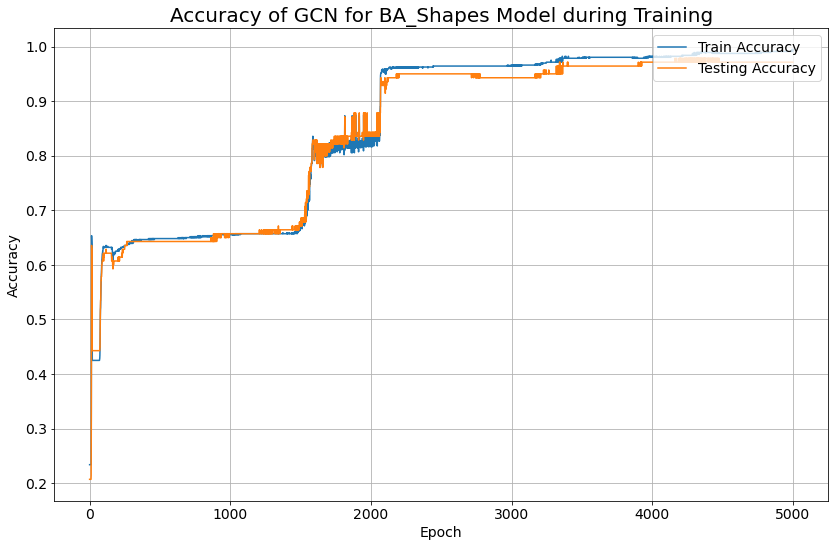

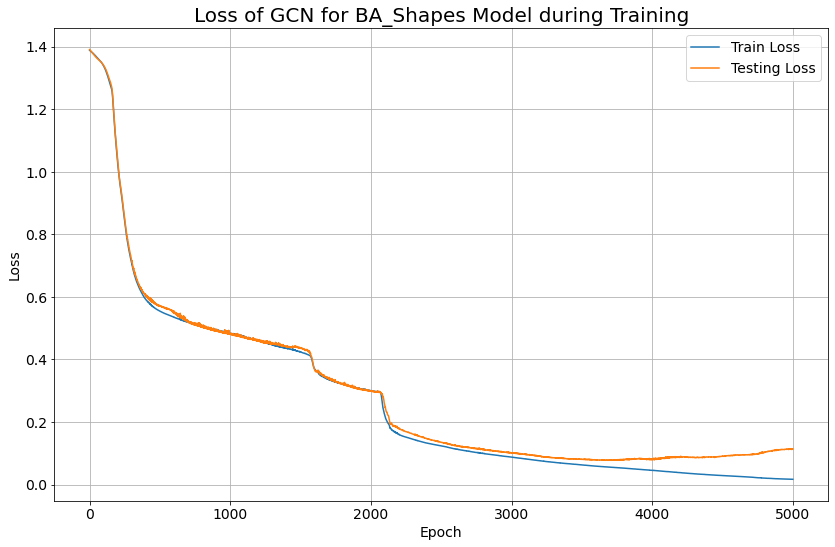

Explanation class 0: feature0000000001_0000000009 - acc. = 0.9782 - compl. = 1.0000
Explanation class 1: (feature0000000001_0000000008 & ~feature0000000002_0000000009) | (feature0000000001_0000000009 & ~feature0000000002_0000000005) - acc. = 0.9576 - compl. = 4.0000
Explanation class 2: feature0000000001_0000000005 - acc. = 0.8223 - compl. = 1.0000
Explanation class 3: feature0000000000_0000000001 & ~feature0000000000_0000000009 - acc. = 0.7026 - compl. = 2.0000
Number of cenroids: 19


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()


Concept homogeneity score: 0.8972879265627395
Concept completeness score: 0.603331294399618
Cluster sizes by cluster id:
	Cluster 0: 2
	Cluster 1: 7
	Cluster 2: 89
	Cluster 3: 34
	Cluster 4: 3
	Cluster 5: 4
	Cluster 6: 7
	Cluster 7: 13
	Cluster 8: 104
	Cluster 9: 27
	Cluster 10: 7
	Cluster 11: 27
	Cluster 12: 72
	Cluster 13: 1
	Cluster 14: 293
	Cluster 15: 2
	Cluster 16: 4
	Cluster 17: 3
	Cluster 18: 1


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

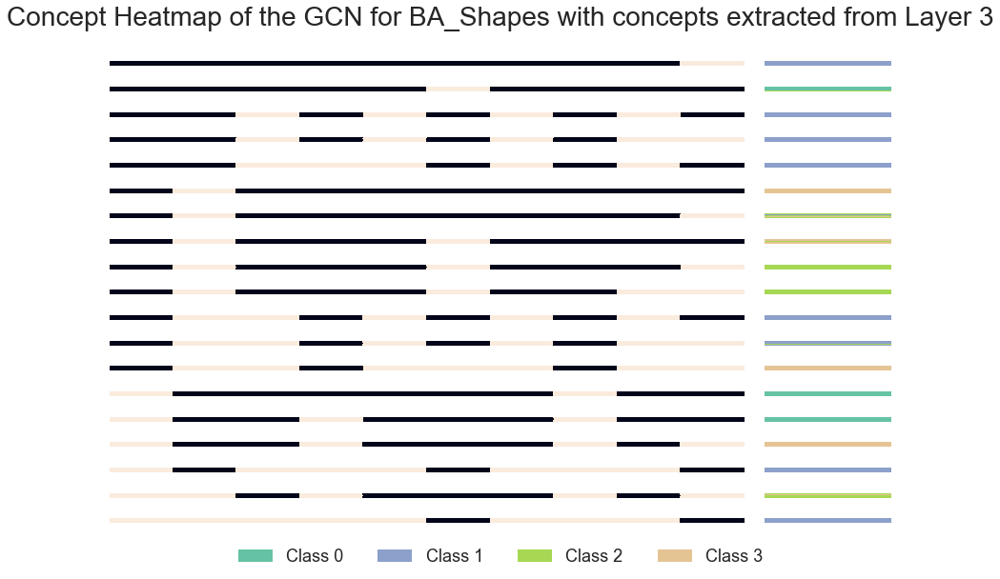

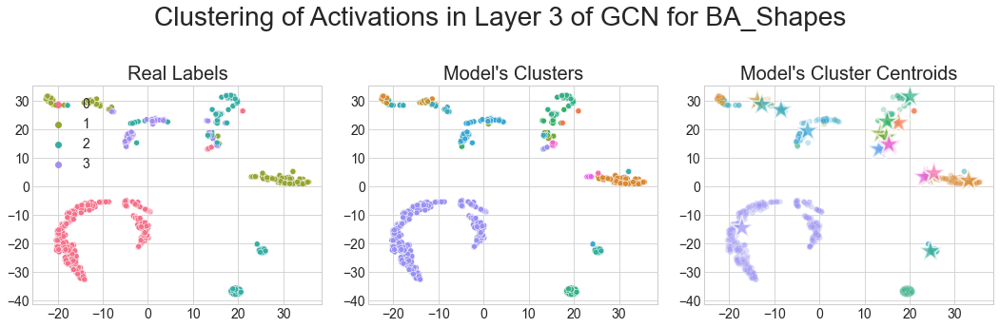

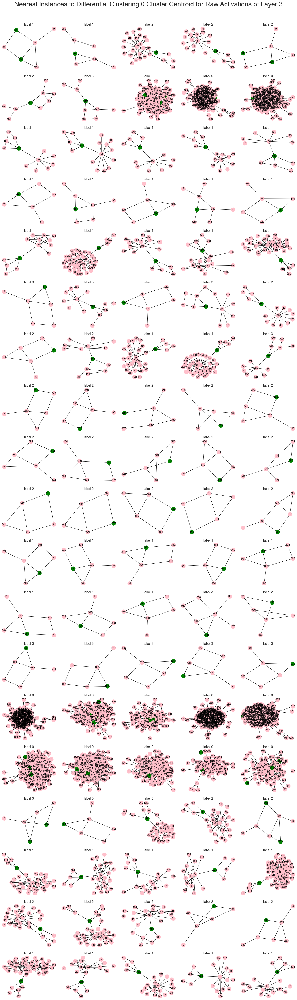

Number of cenroids: 15


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()


Concept homogeneity score: 0.9341356538166921
Concept completeness score: 0.6598490605532409
Cluster sizes by cluster id:
	Cluster 0: 18
	Cluster 1: 2
	Cluster 2: 1
	Cluster 3: 6
	Cluster 4: 70
	Cluster 5: 70
	Cluster 6: 287
	Cluster 7: 2
	Cluster 8: 1
	Cluster 9: 76
	Cluster 10: 75
	Cluster 11: 5
	Cluster 12: 3
	Cluster 13: 82
	Cluster 14: 2


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

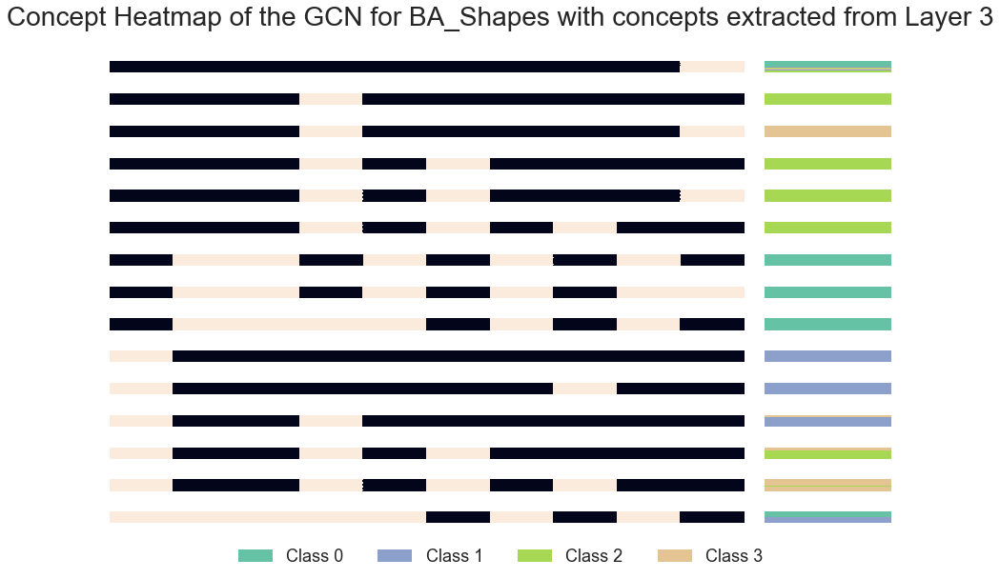

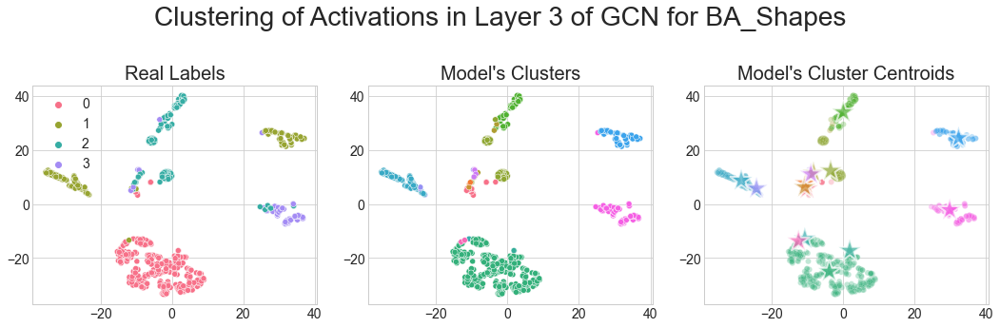

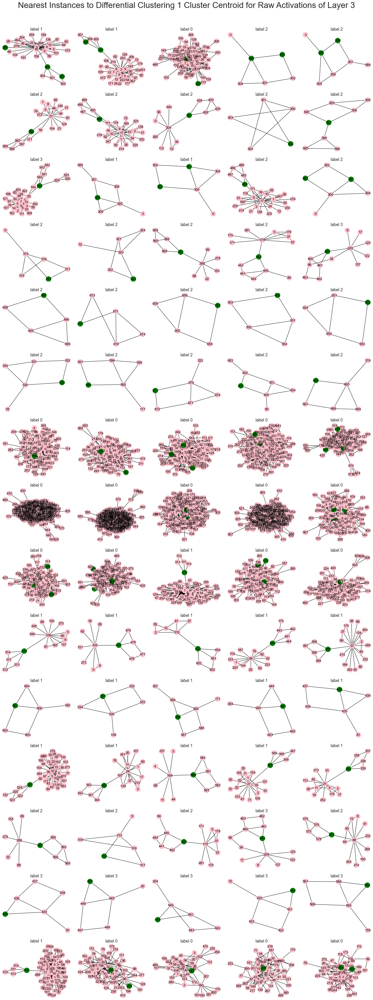

Number of cenroids: 16


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()


Concept homogeneity score: 0.8425996379760846
Concept completeness score: 0.7331285698645755
Cluster sizes by cluster id:
	Cluster 0: 318
	Cluster 1: 2
	Cluster 2: 1
	Cluster 3: 19
	Cluster 4: 1
	Cluster 5: 1
	Cluster 6: 144
	Cluster 7: 1
	Cluster 8: 2
	Cluster 9: 1
	Cluster 10: 1
	Cluster 11: 3
	Cluster 12: 3
	Cluster 13: 132
	Cluster 14: 2
	Cluster 15: 69


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

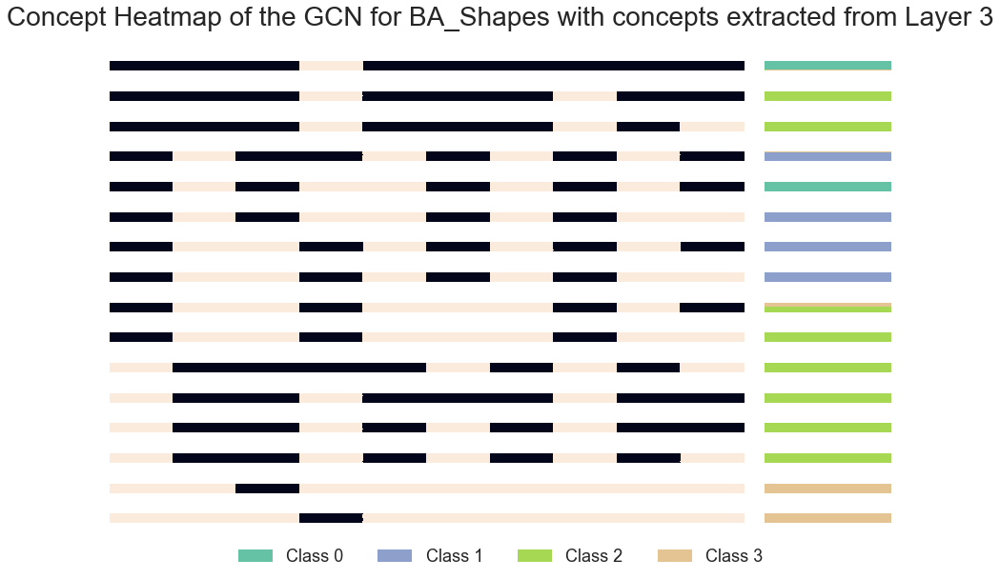

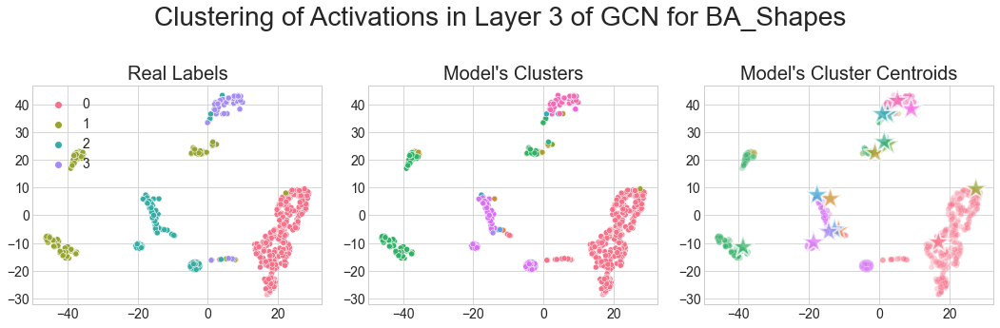

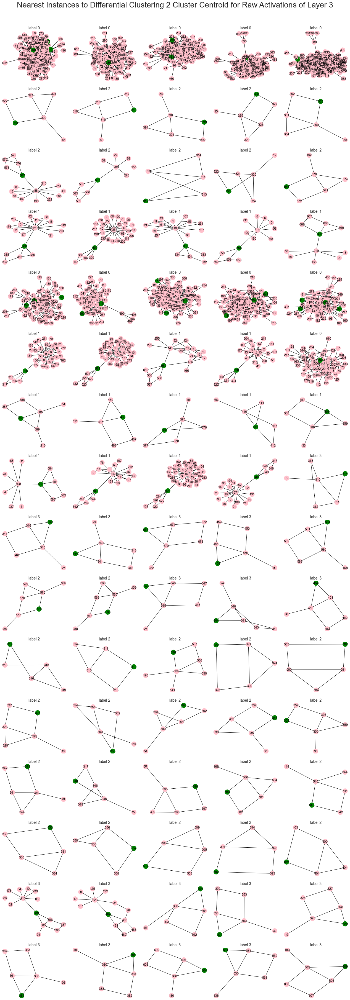

Global seed set to 19



END EXPERIMENT-------------------------------------------


START EXPERIMENT-----------------------------------------



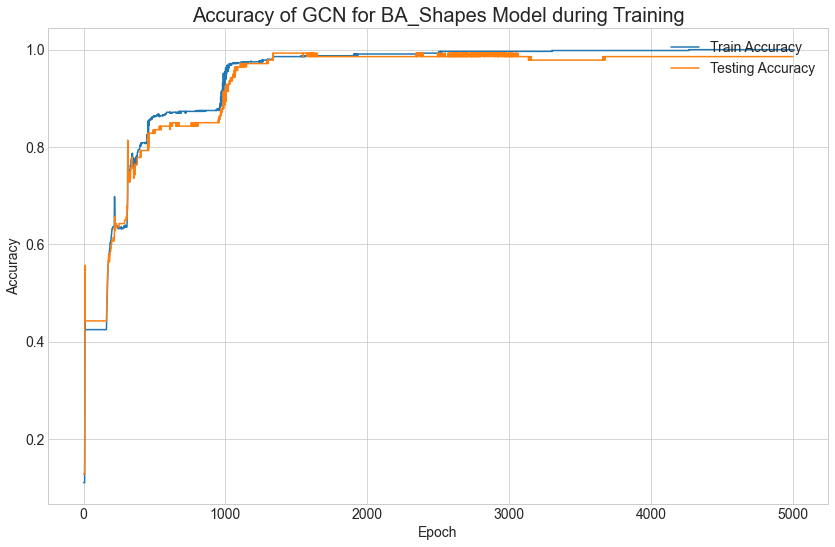

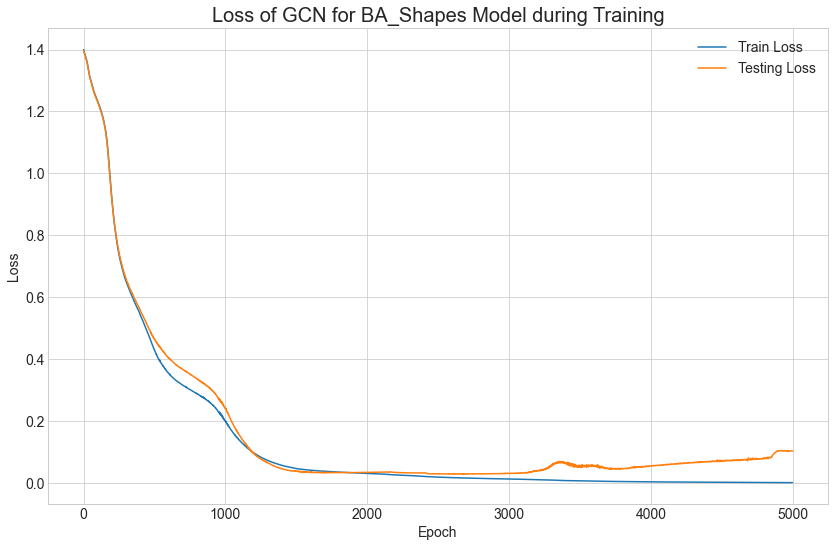

Explanation class 0: feature0000000000_0000000008 | (feature0000000000_0000000007 & ~feature0000000000_0000000009) | (~feature0000000000_0000000003 & ~feature0000000000_0000000004 & ~feature0000000000_0000000006) | (~feature0000000000_0000000003 & ~feature0000000000_0000000004 & ~feature0000000001_0000000009) - acc. = 0.7217 - compl. = 9.0000
Explanation class 1: ~feature0000000002_0000000005 & ~feature0000000002_0000000007 & ~feature0000000002_0000000009 - acc. = 0.9890 - compl. = 3.0000
Explanation class 2: feature0000000002_0000000007 | (feature0000000002_0000000008 & feature0000000002_0000000009) | (feature0000000002_0000000006 & ~feature0000000002_0000000002) | (feature0000000002_0000000005 & ~feature0000000002_0000000006 & ~feature0000000002_0000000009) | (~feature0000000002_0000000005 & ~feature0000000002_0000000008 & ~feature0000000002_0000000009) - acc. = 0.9595 - compl. = 11.0000
Explanation class 3: None - acc. = 0.0000 - compl. = 0.0000
Number of cenroids: 15


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()


Concept homogeneity score: 0.8589552932965588
Concept completeness score: 0.5945546486408831
Cluster sizes by cluster id:
	Cluster 0: 1
	Cluster 1: 50
	Cluster 2: 49
	Cluster 3: 18
	Cluster 4: 174
	Cluster 5: 1
	Cluster 6: 199
	Cluster 7: 13
	Cluster 8: 26
	Cluster 9: 9
	Cluster 10: 2
	Cluster 11: 1
	Cluster 12: 149
	Cluster 13: 3
	Cluster 14: 5


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

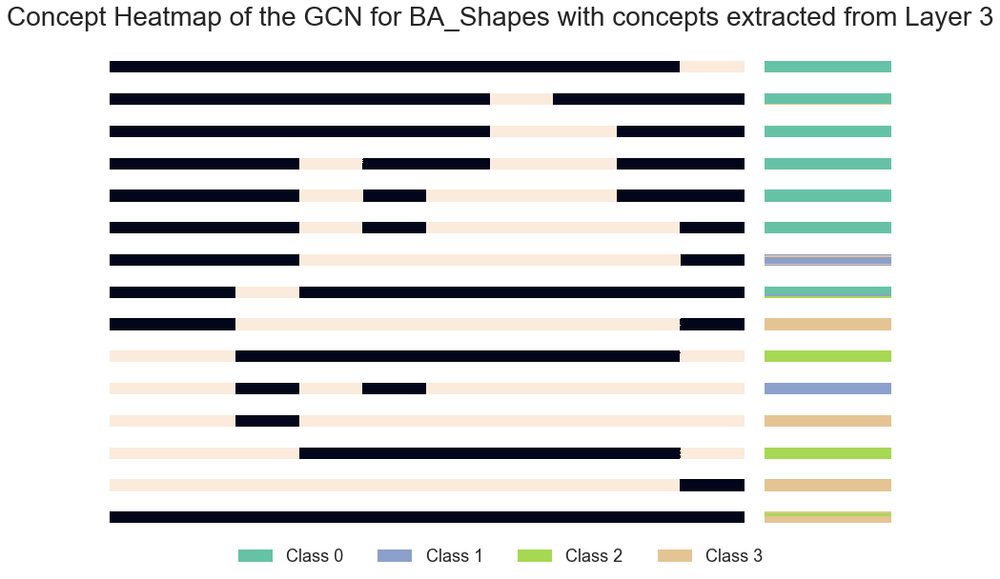

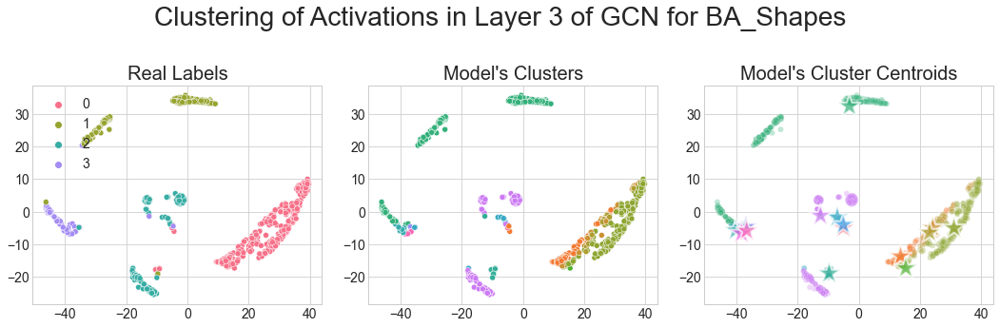

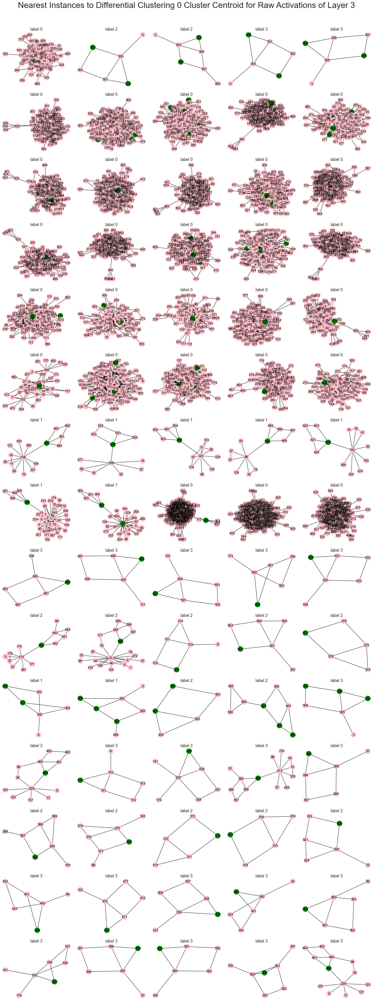

Number of cenroids: 15


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()


Concept homogeneity score: 0.7539400415389836
Concept completeness score: 0.5517358595453711
Cluster sizes by cluster id:
	Cluster 0: 235
	Cluster 1: 24
	Cluster 2: 15
	Cluster 3: 2
	Cluster 4: 3
	Cluster 5: 11
	Cluster 6: 33
	Cluster 7: 19
	Cluster 8: 175
	Cluster 9: 19
	Cluster 10: 2
	Cluster 11: 3
	Cluster 12: 156
	Cluster 13: 1
	Cluster 14: 2


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

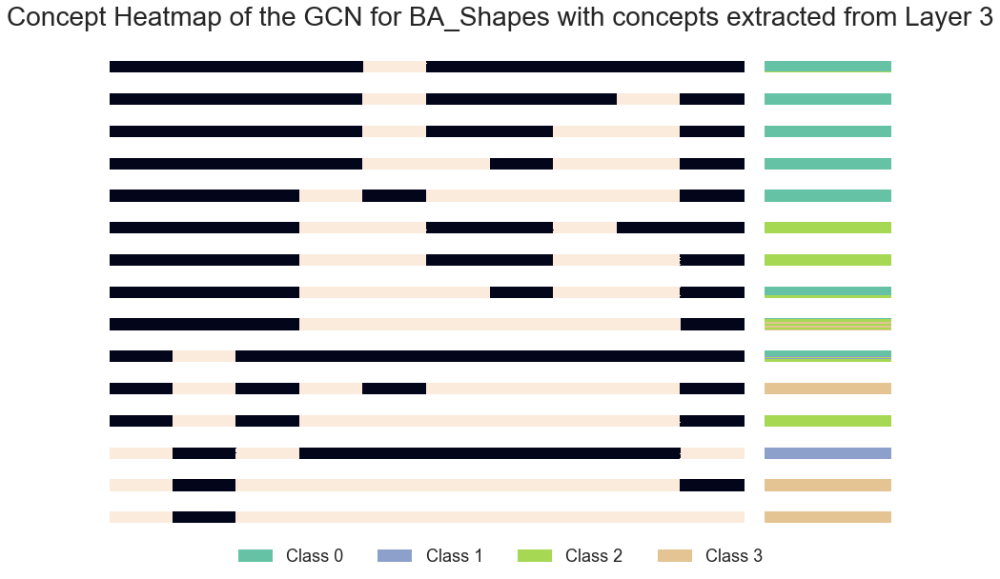

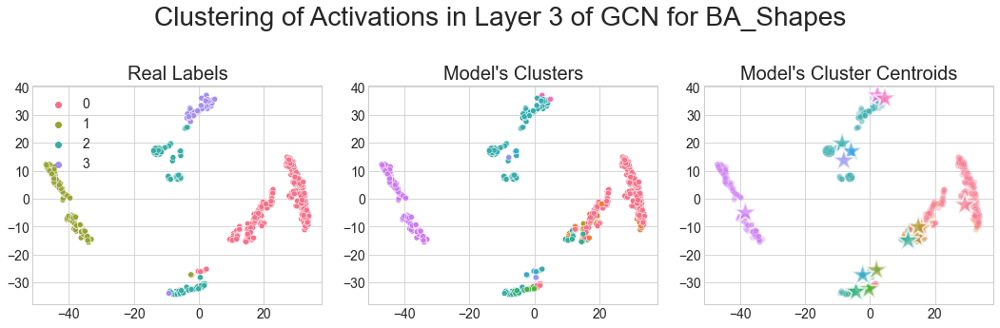

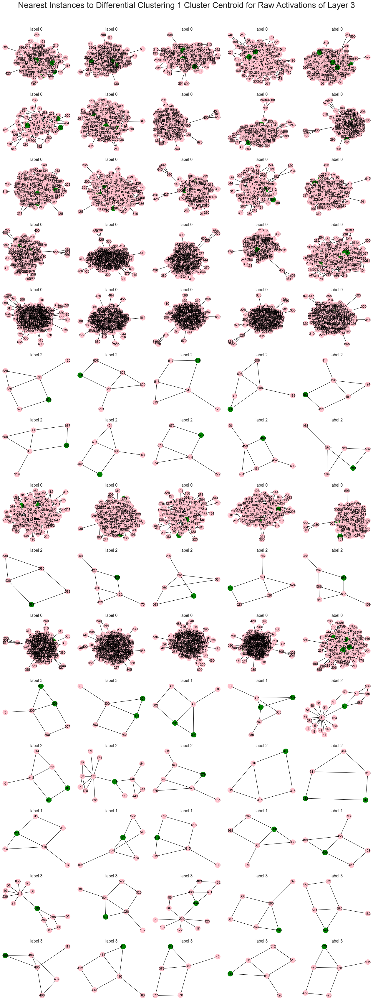

Number of cenroids: 11
Concept homogeneity score: 0.9333406745393881
Concept completeness score: 0.7252228698763518
Cluster sizes by cluster id:
	Cluster 0: 79
	Cluster 1: 64
	Cluster 2: 27
	Cluster 3: 130
	Cluster 4: 1
	Cluster 5: 78
	Cluster 6: 1
	Cluster 7: 7
	Cluster 8: 9
	Cluster 9: 301
	Cluster 10: 3


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

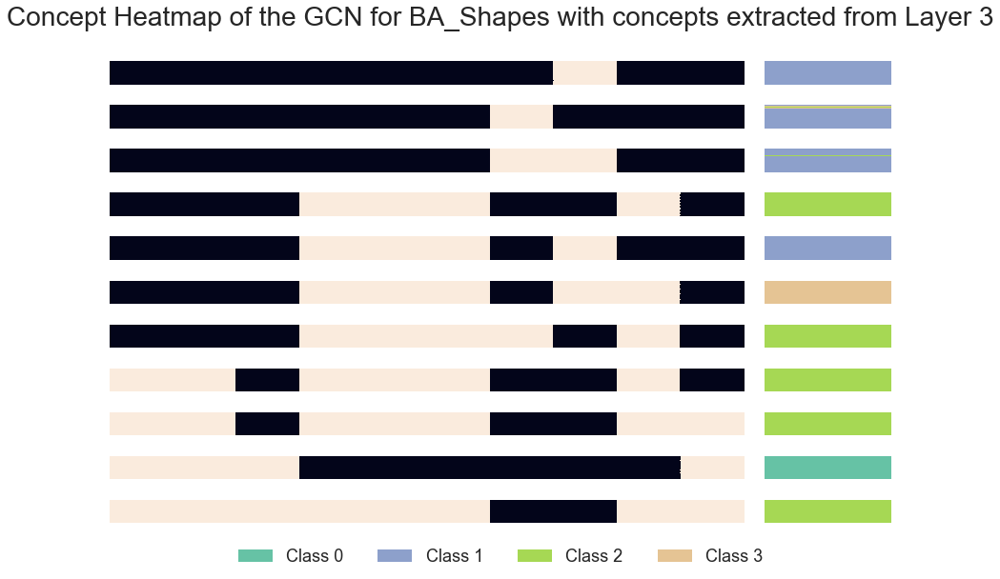

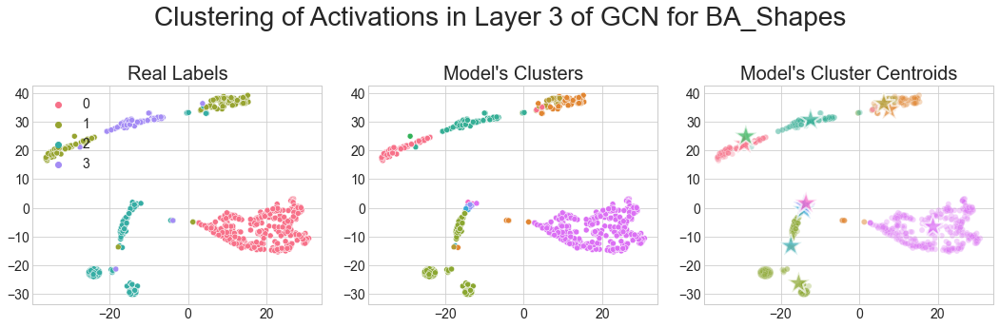

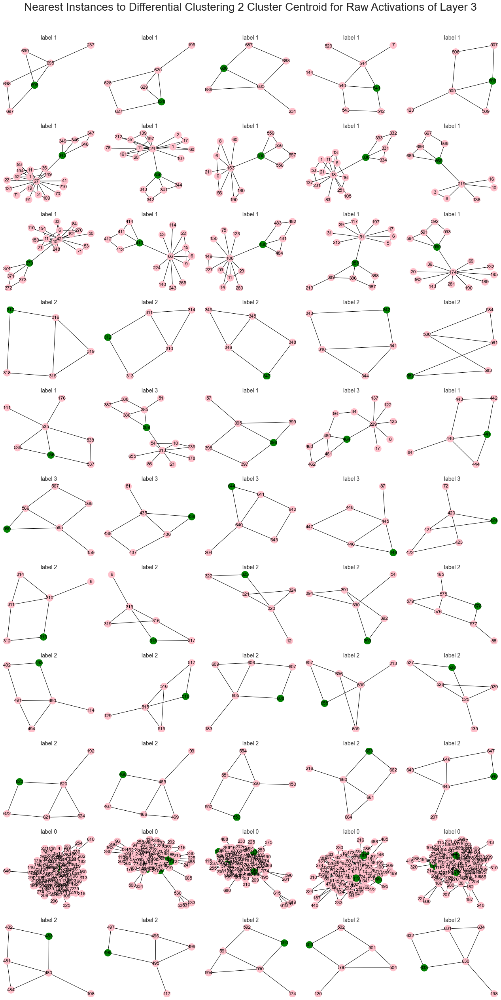

Global seed set to 76



END EXPERIMENT-------------------------------------------


START EXPERIMENT-----------------------------------------



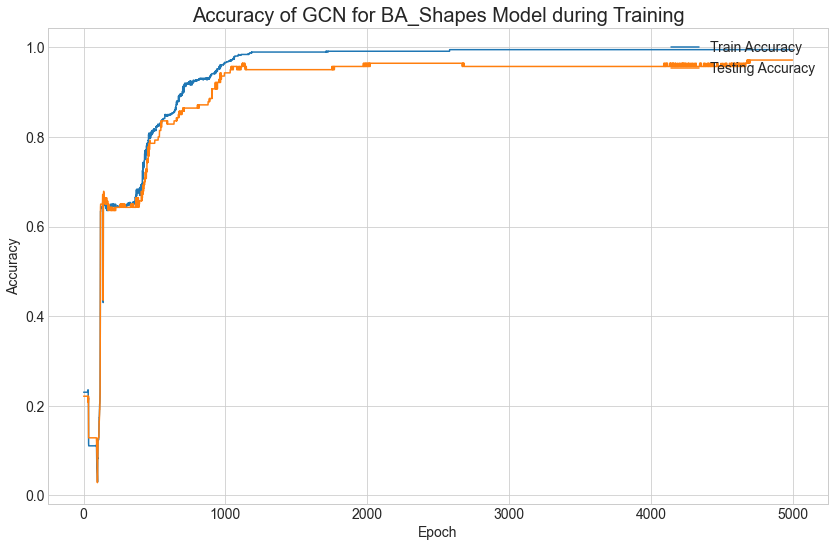

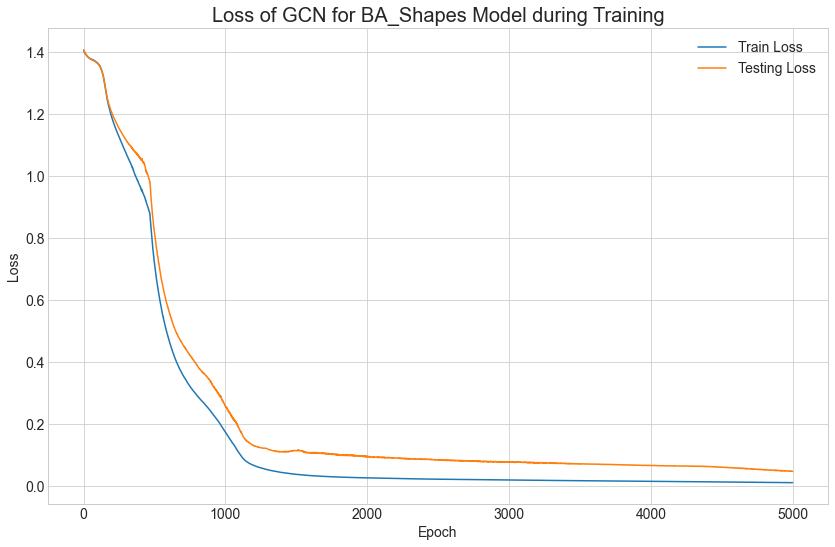

Explanation class 0: None - acc. = 0.0000 - compl. = 0.0000
Explanation class 1: (feature0000000000_0000000003 & ~feature0000000000_0000000006) | (~feature0000000000_0000000002 & ~feature0000000000_0000000006 & ~feature0000000000_0000000008) - acc. = 0.9488 - compl. = 5.0000
Explanation class 2: ~feature0000000002_0000000007 & ~feature0000000002_0000000008 - acc. = 0.9509 - compl. = 2.0000
Explanation class 3: (feature0000000001_0000000002 & feature0000000001_0000000009) | (feature0000000001_0000000005 & ~feature0000000001_0000000008) | (feature0000000001_0000000009 & ~feature0000000001_0000000007) - acc. = 0.9510 - compl. = 6.0000
Number of cenroids: 8
Concept homogeneity score: 0.6395278742848263
Concept completeness score: 0.8086127625212066
Cluster sizes by cluster id:
	Cluster 0: 12
	Cluster 1: 155
	Cluster 2: 3
	Cluster 3: 85
	Cluster 4: 440
	Cluster 5: 1
	Cluster 6: 3
	Cluster 7: 1


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

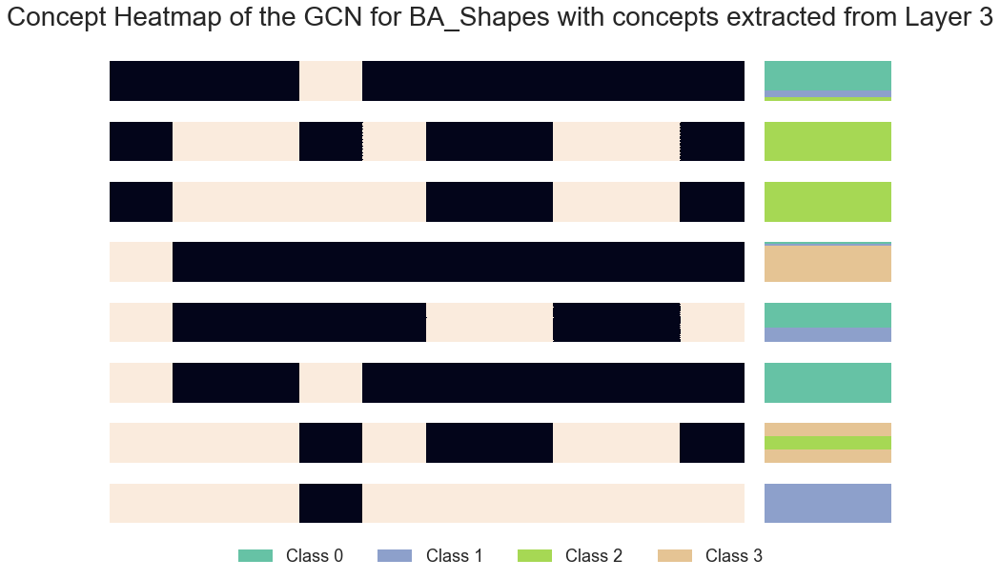

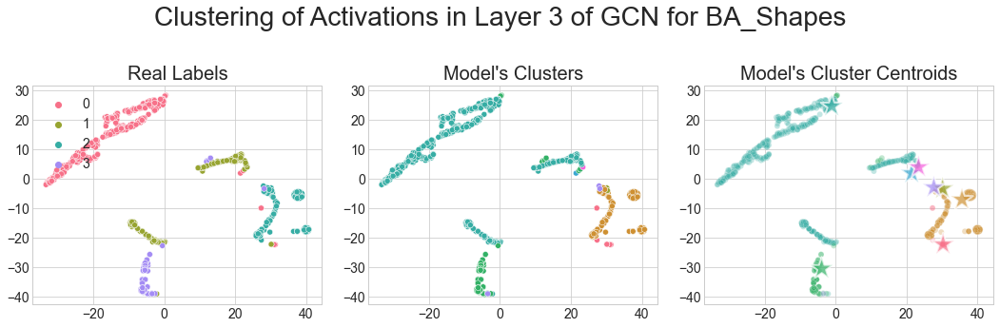

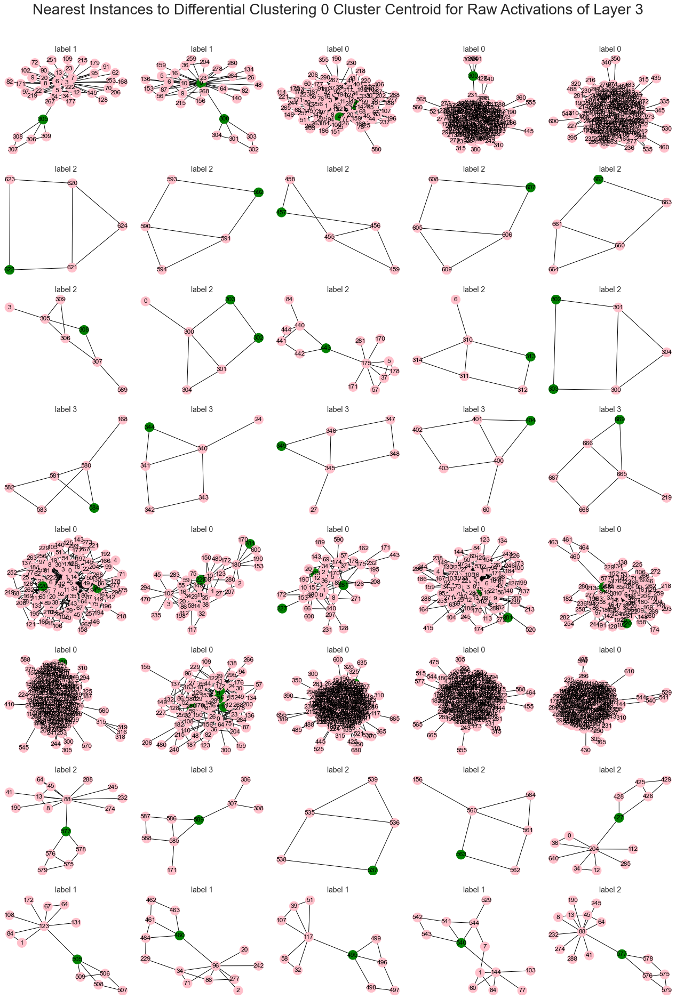

Number of cenroids: 10
Concept homogeneity score: 0.74319889629431
Concept completeness score: 0.7453798263139553
Cluster sizes by cluster id:
	Cluster 0: 164
	Cluster 1: 1
	Cluster 2: 3
	Cluster 3: 85
	Cluster 4: 72
	Cluster 5: 365
	Cluster 6: 4
	Cluster 7: 2
	Cluster 8: 2
	Cluster 9: 2


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

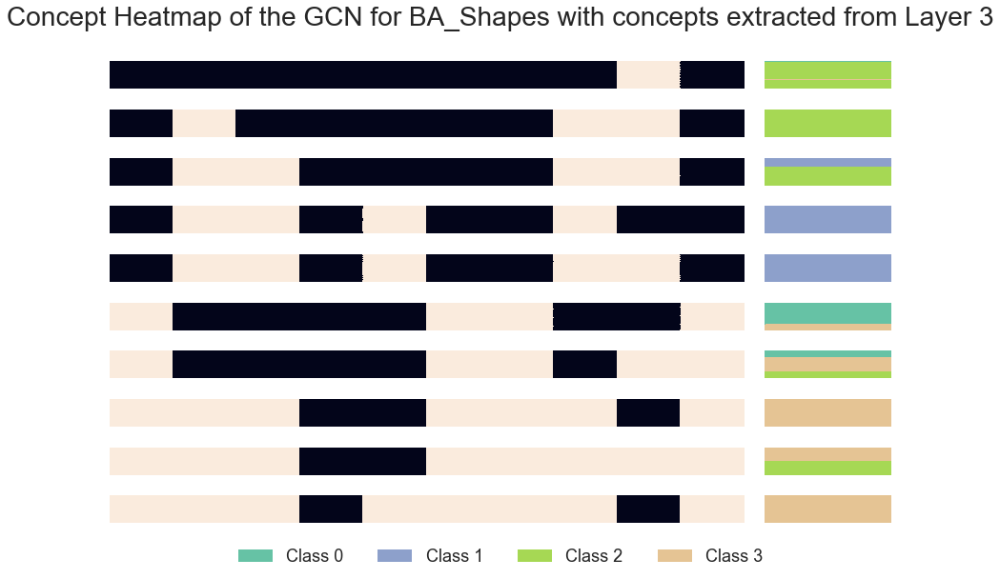

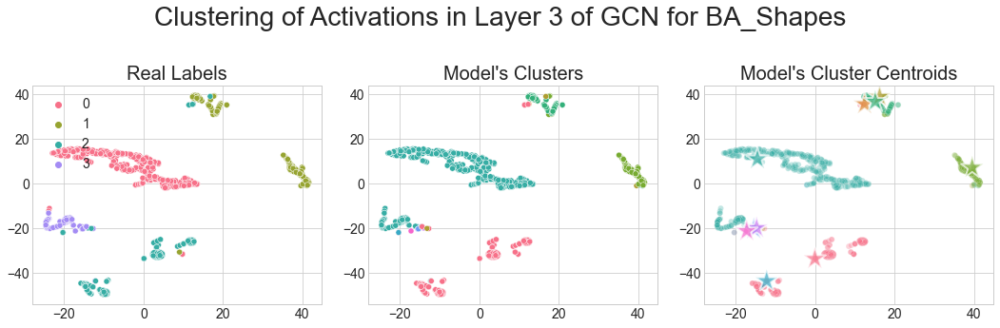

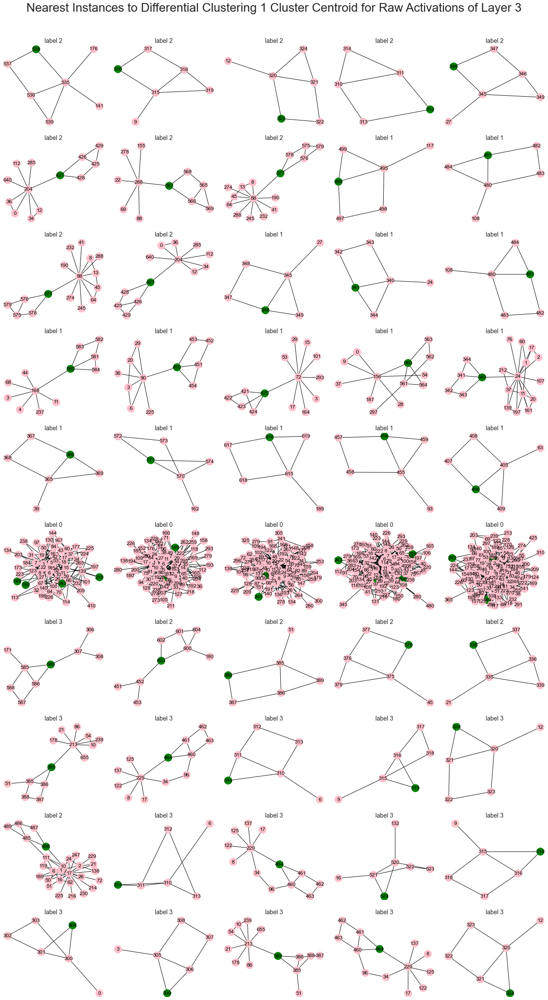

Number of cenroids: 5
Concept homogeneity score: 0.6876624823468641
Concept completeness score: 0.8549977764463994
Cluster sizes by cluster id:
	Cluster 0: 9
	Cluster 1: 321
	Cluster 2: 75
	Cluster 3: 293
	Cluster 4: 2


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

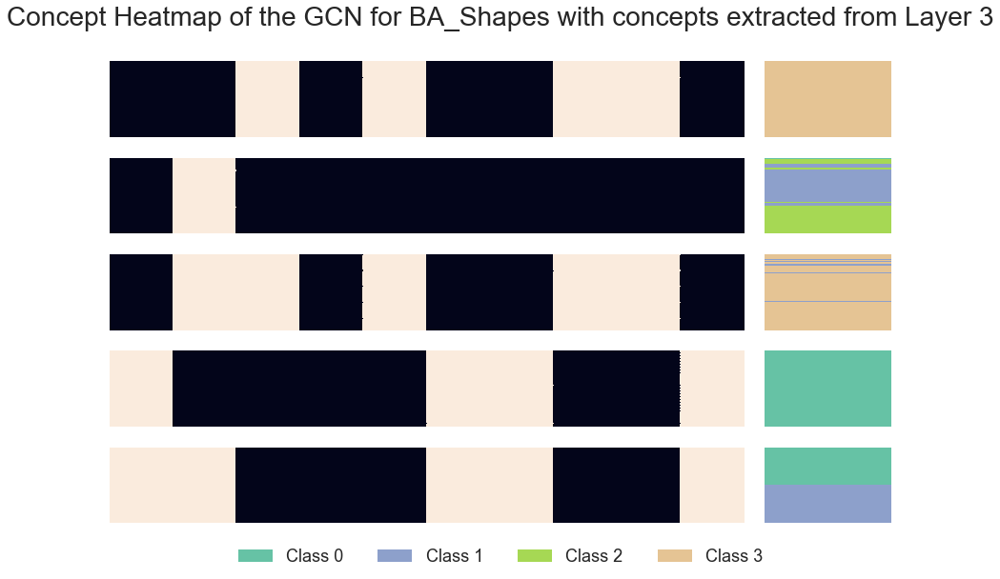

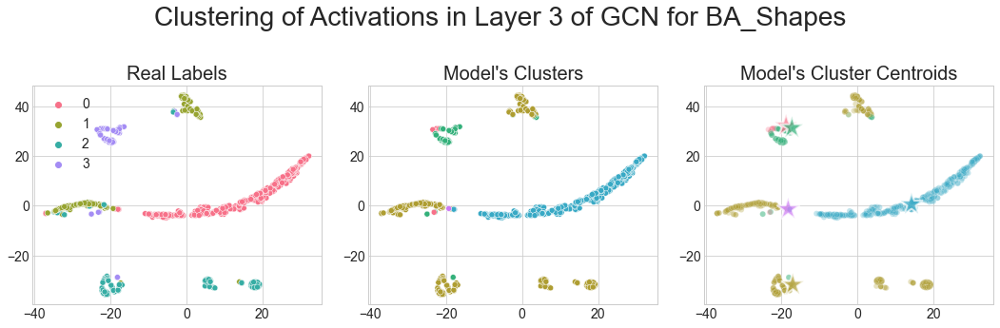

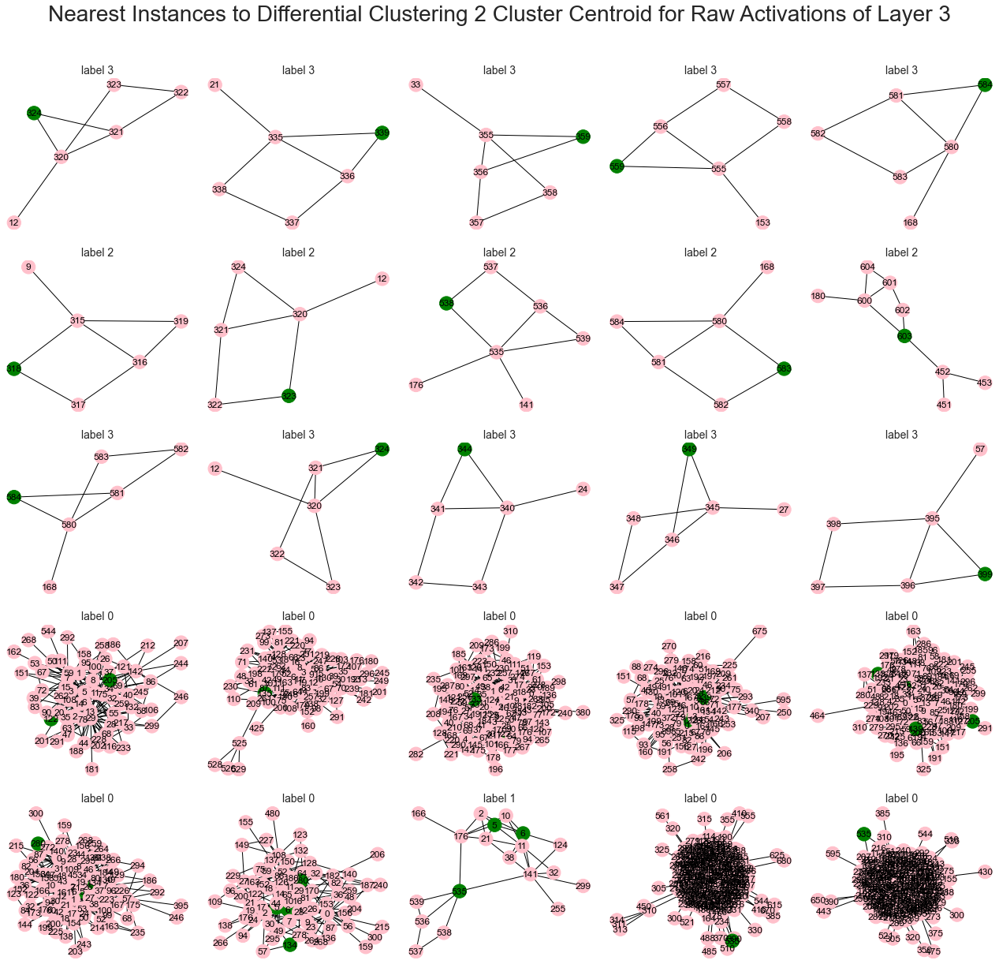

Global seed set to 58



END EXPERIMENT-------------------------------------------


START EXPERIMENT-----------------------------------------



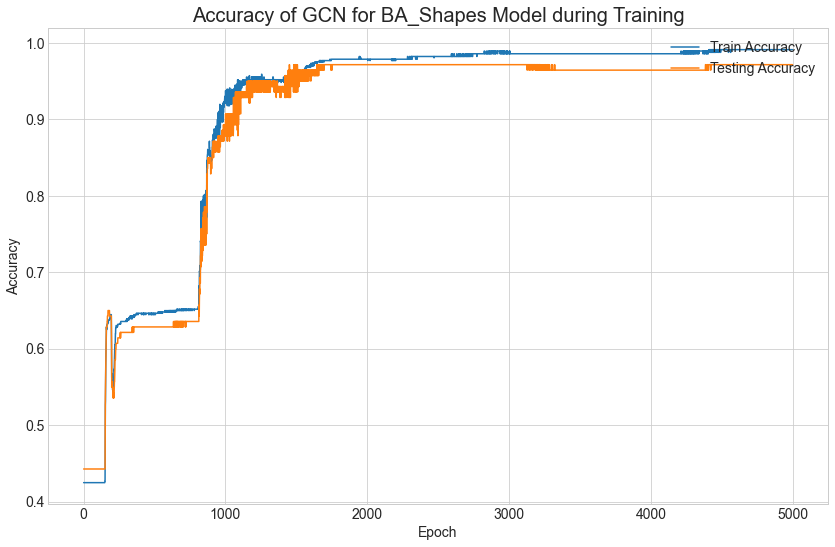

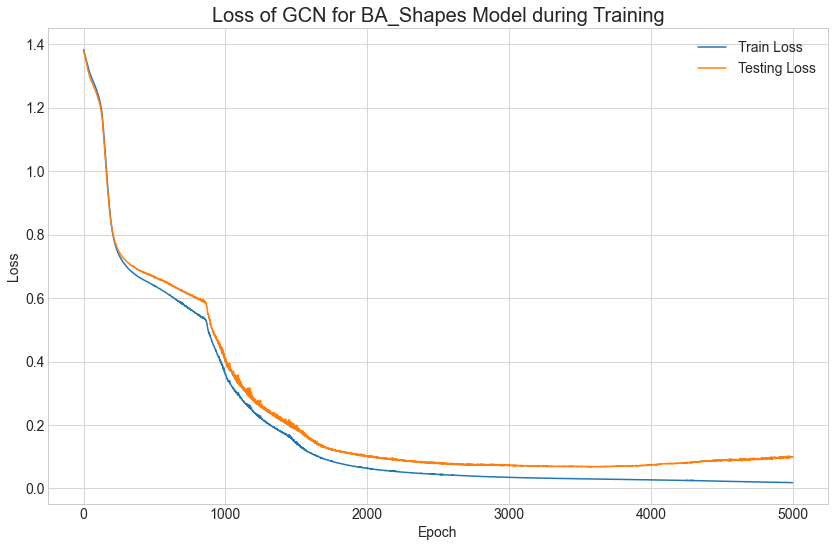

Explanation class 0: feature0000000002_0000000005 & feature0000000002_0000000007 & ~feature0000000002_0000000008 - acc. = 0.3578 - compl. = 3.0000
Explanation class 1: ~feature0000000002_0000000005 & ~feature0000000002_0000000008 & ~feature0000000002_0000000009 - acc. = 0.3318 - compl. = 3.0000
Explanation class 2: None - acc. = 0.0000 - compl. = 0.0000
Explanation class 3: feature0000000000_0000000009 - acc. = 0.3103 - compl. = 1.0000
Number of cenroids: 9
Concept homogeneity score: 0.7880217252037696
Concept completeness score: 0.7642836946324058
Cluster sizes by cluster id:
	Cluster 0: 244
	Cluster 1: 4
	Cluster 2: 19
	Cluster 3: 137
	Cluster 4: 22
	Cluster 5: 1
	Cluster 6: 270
	Cluster 7: 1
	Cluster 8: 2


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

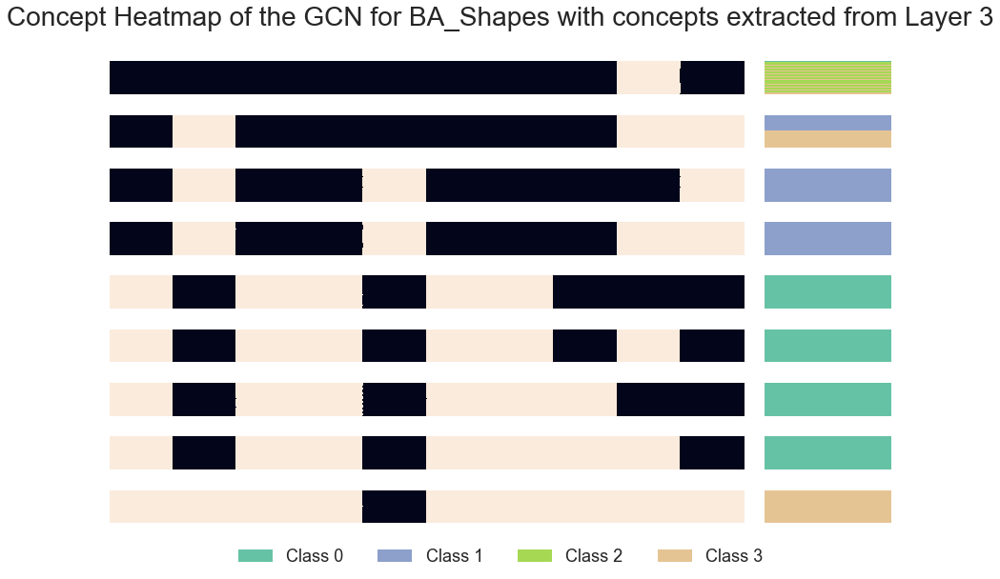

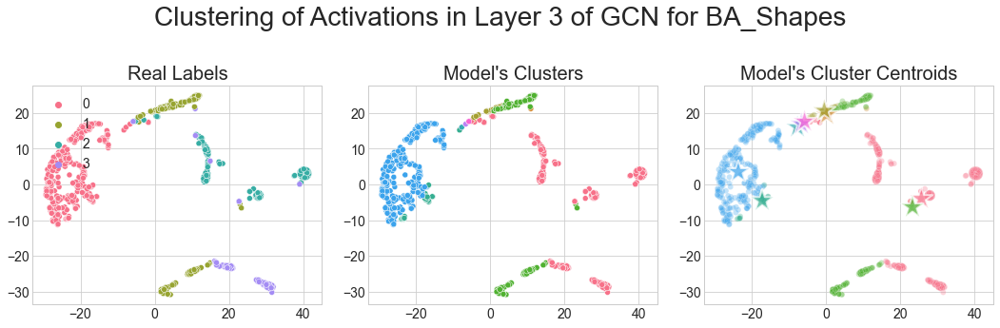

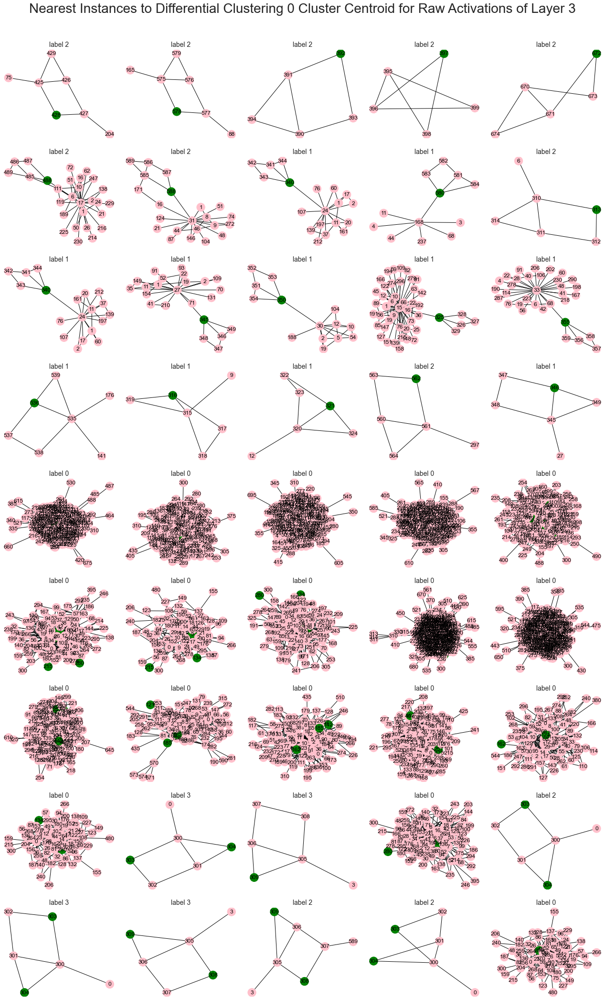

Number of cenroids: 10
Concept homogeneity score: 0.7327276656906939
Concept completeness score: 0.6517744198626311
Cluster sizes by cluster id:
	Cluster 0: 10
	Cluster 1: 115
	Cluster 2: 26
	Cluster 3: 9
	Cluster 4: 30
	Cluster 5: 212
	Cluster 6: 292
	Cluster 7: 1
	Cluster 8: 1
	Cluster 9: 4


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

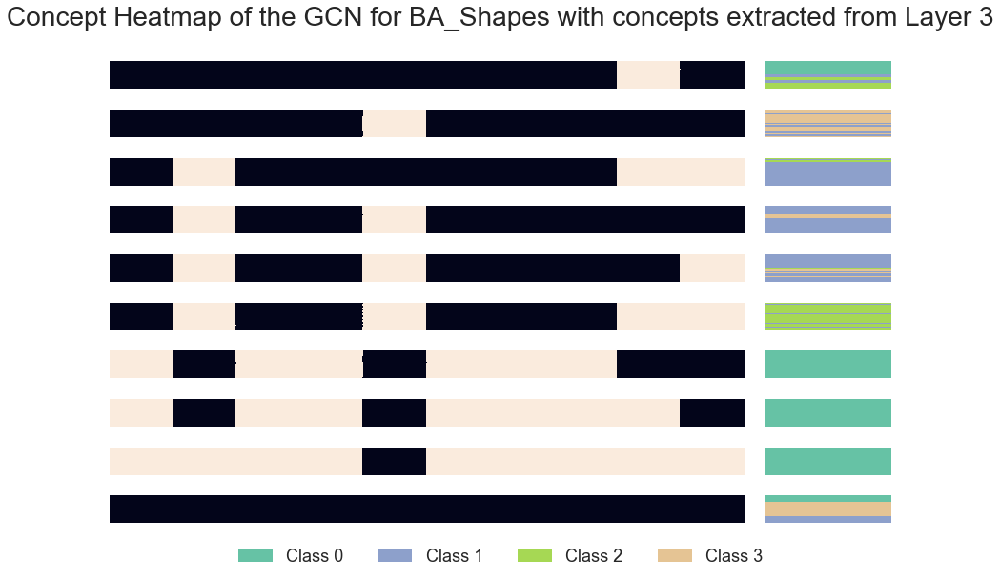

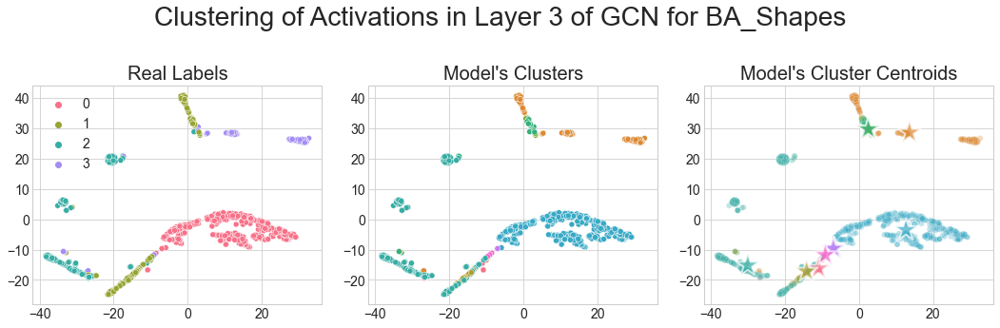

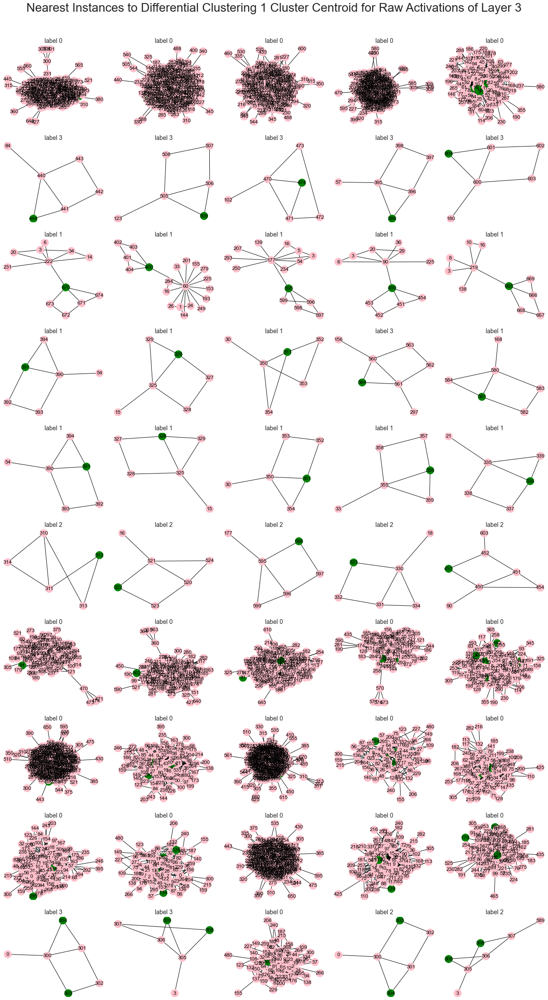

Number of cenroids: 8
Concept homogeneity score: 0.7012335650049785
Concept completeness score: 0.6841597771050925
Cluster sizes by cluster id:
	Cluster 0: 253
	Cluster 1: 34
	Cluster 2: 5
	Cluster 3: 1
	Cluster 4: 1
	Cluster 5: 111
	Cluster 6: 278
	Cluster 7: 17


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

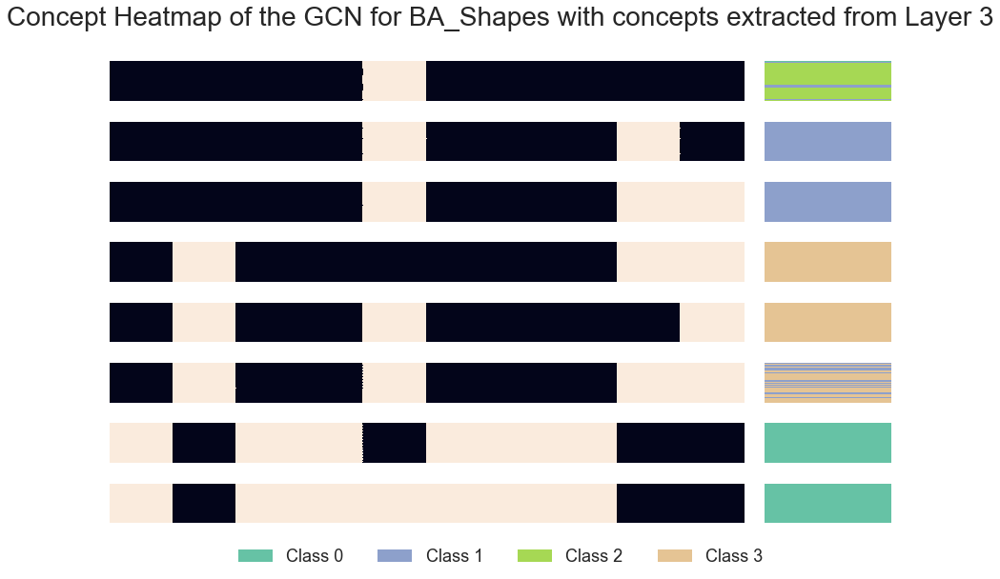

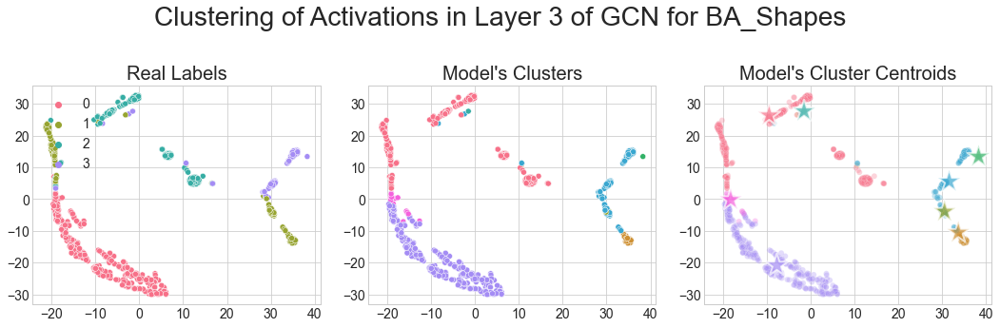

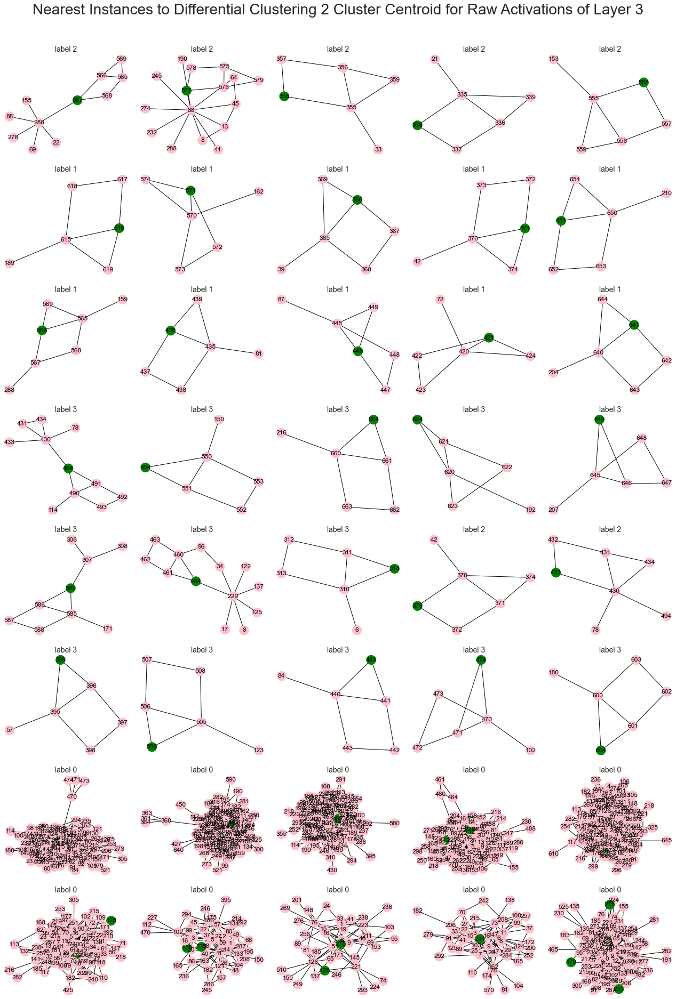

Global seed set to 92



END EXPERIMENT-------------------------------------------


START EXPERIMENT-----------------------------------------



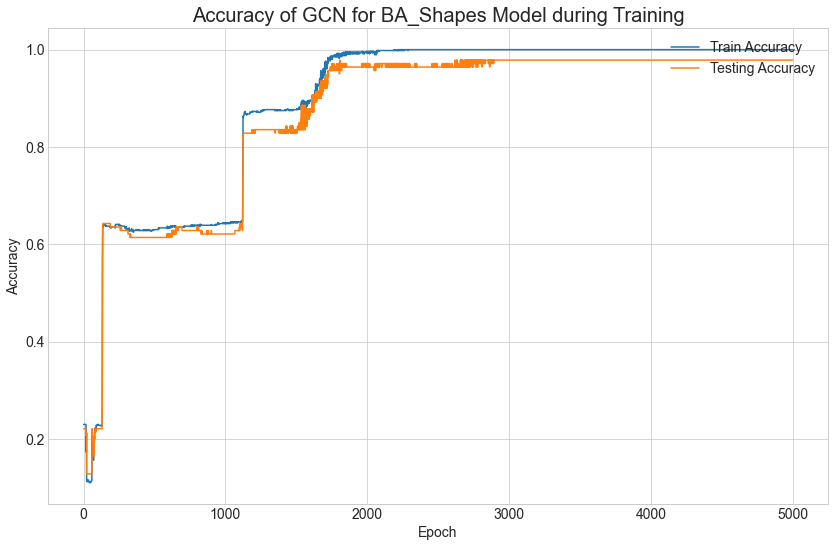

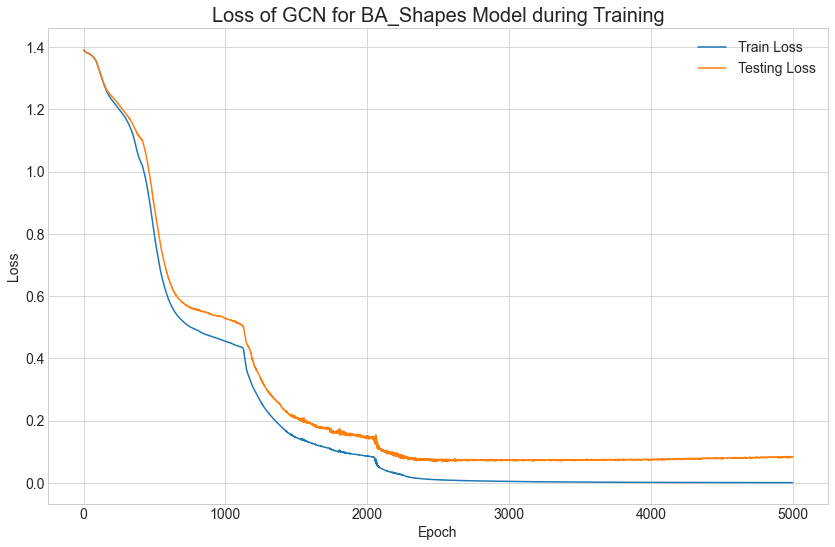

Explanation class 0: feature0000000001_0000000007 - acc. = 0.4701 - compl. = 1.0000
Explanation class 1: feature0000000001_0000000007 & feature0000000001_0000000008 - acc. = 1.0000 - compl. = 2.0000
Explanation class 2: feature0000000002_0000000001 & ~feature0000000002_0000000005 & ~feature0000000002_0000000006 - acc. = 0.9686 - compl. = 3.0000
Explanation class 3: None - acc. = 0.0000 - compl. = 0.0000
Number of cenroids: 8
Concept homogeneity score: 0.5829531657913856
Concept completeness score: 0.6789837528356434
Cluster sizes by cluster id:
	Cluster 0: 300
	Cluster 1: 6
	Cluster 2: 114
	Cluster 3: 1
	Cluster 4: 1
	Cluster 5: 1
	Cluster 6: 1
	Cluster 7: 276


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

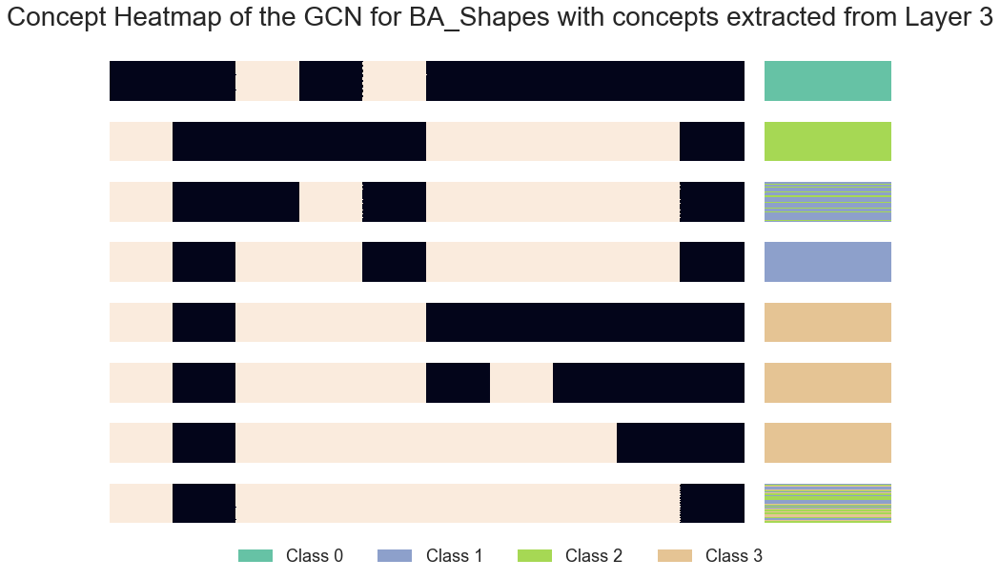

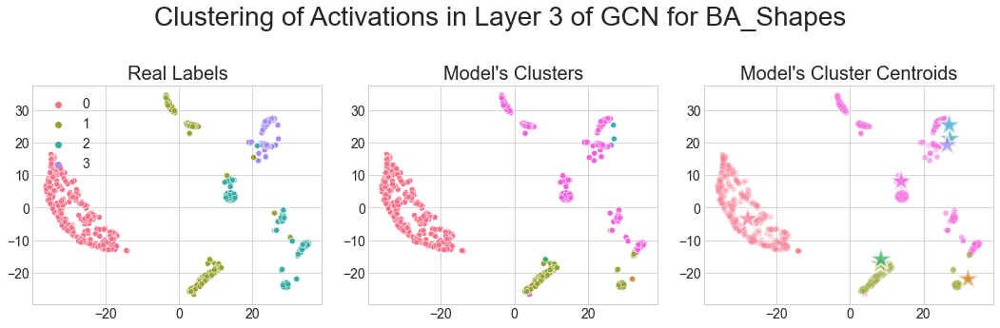

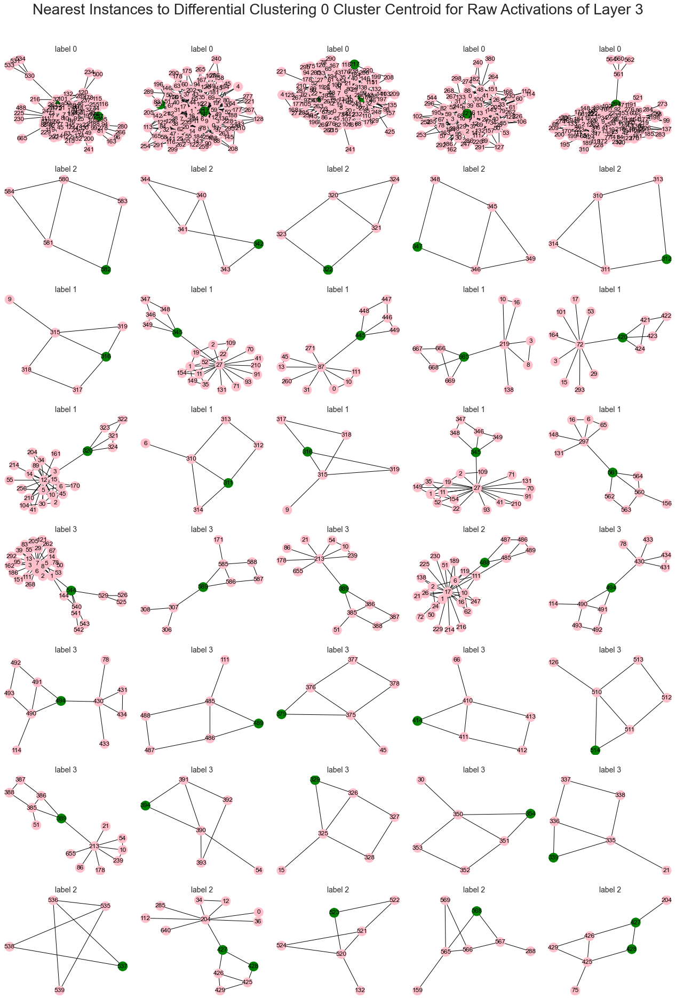

Number of cenroids: 19


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()


Concept homogeneity score: 0.9437593659046585
Concept completeness score: 0.6472259134904582
Cluster sizes by cluster id:
	Cluster 0: 9
	Cluster 1: 2
	Cluster 2: 3
	Cluster 3: 143
	Cluster 4: 3
	Cluster 5: 58
	Cluster 6: 23
	Cluster 7: 2
	Cluster 8: 2
	Cluster 9: 301
	Cluster 10: 18
	Cluster 11: 14
	Cluster 12: 9
	Cluster 13: 14
	Cluster 14: 1
	Cluster 15: 1
	Cluster 16: 29
	Cluster 17: 7
	Cluster 18: 61


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

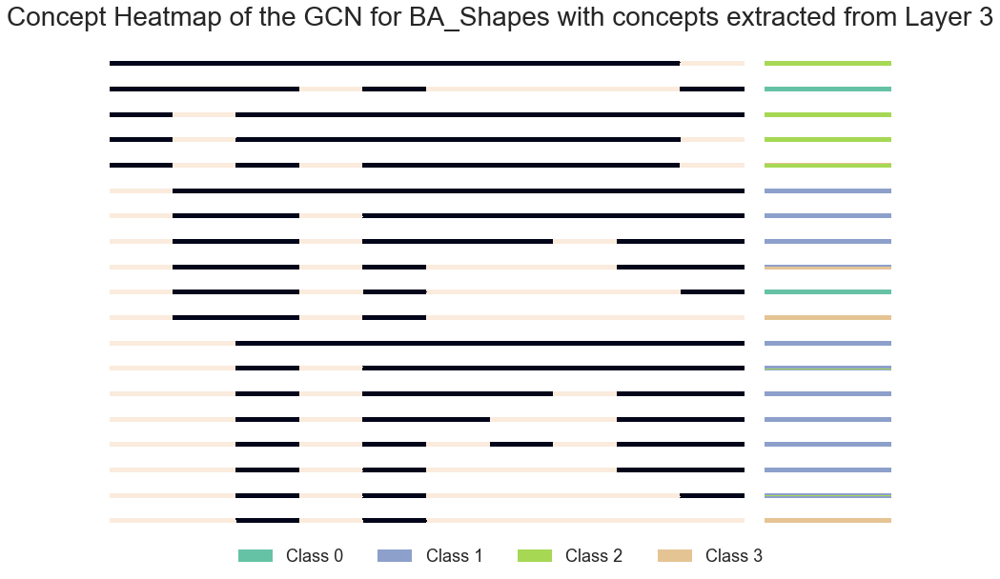

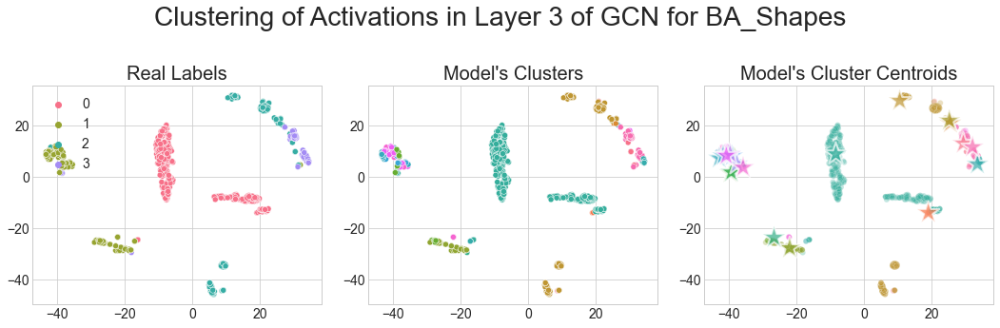

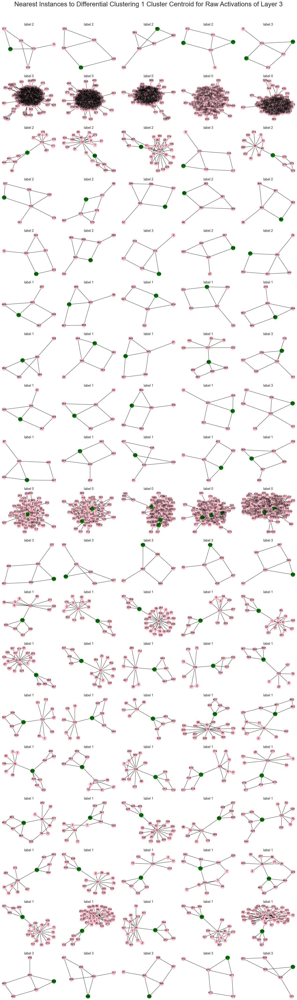

Number of cenroids: 26


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/src/visualisation_utils.py:87: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  plt.savefig(os.path.join(path, f"concept_heatmap_layer{layer_num}.png"))


Concept homogeneity score: 0.8270017812696855
Concept completeness score: 0.4707945509570049
Cluster sizes by cluster id:
	Cluster 0: 12
	Cluster 1: 2
	Cluster 2: 4
	Cluster 3: 234
	Cluster 4: 30
	Cluster 5: 103
	Cluster 6: 32
	Cluster 7: 25
	Cluster 8: 61
	Cluster 9: 96
	Cluster 10: 11
	Cluster 11: 1
	Cluster 12: 6
	Cluster 13: 6
	Cluster 14: 5
	Cluster 15: 1
	Cluster 16: 1
	Cluster 17: 2
	Cluster 18: 4
	Cluster 19: 5
	Cluster 20: 1
	Cluster 21: 9
	Cluster 22: 3
	Cluster 23: 25
	Cluster 24: 2
	Cluster 25: 19


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/IPython/core/pylabtools.py:132: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.print_figure(bytes_io, **kw)


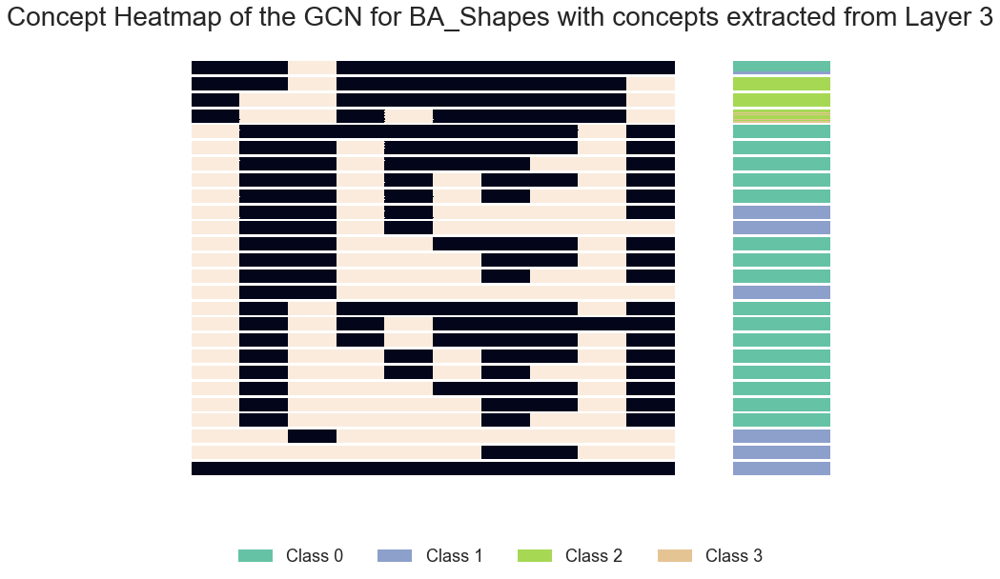

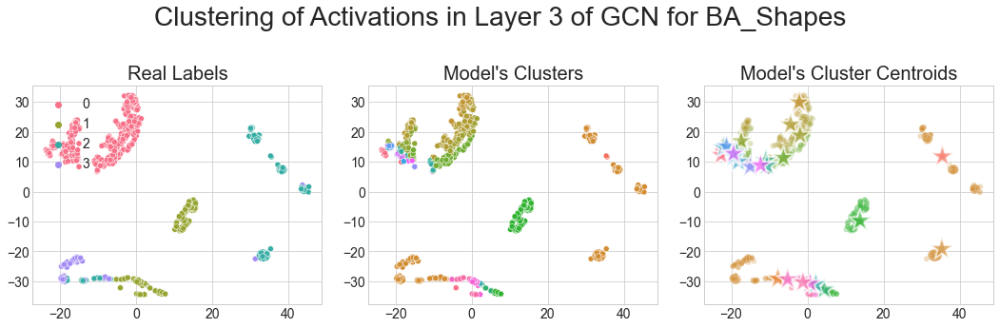

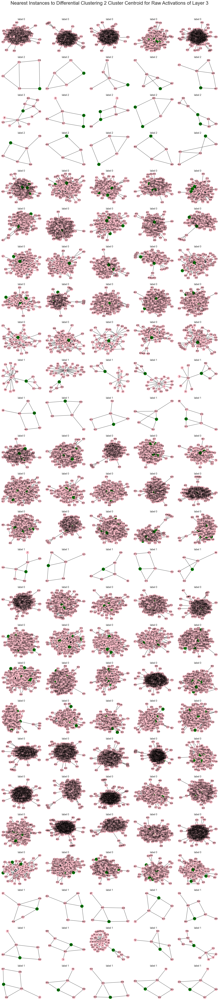


END EXPERIMENT-------------------------------------------



In [5]:
# run multiple times for confidence interval - seeds generated using Google's random number generator
random_seeds = [42, 19, 76, 58, 92]

# load data
G, labels = data_utils.load_syn_data(DATASET_NAME)
data = data_utils.prepare_syn_data(G, labels, TRAIN_TEST_SPLIT)

for seed in random_seeds:
    print("\nSTART EXPERIMENT-----------------------------------------\n")
    seed_everything(seed)
    
    path = os.path.join("..", "output", DATASET_NAME, f"seed_{seed}")
    data_utils.create_path(path)

    run_experiment(data, seed, path)
    
    print("\nEND EXPERIMENT-------------------------------------------\n")